#### Imports

In [1]:
%config InlineBackend.figure_formats = ['retina']
%pylab inline

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
plt.style.use('default')
plt.style.use('fivethirtyeight')
%matplotlib inline
#sns.set(rc={'figure.figsize':(10,8)})

from sklearn.model_selection import train_test_split, cross_val_score, KFold
from sklearn.linear_model import LinearRegression, Lasso
from sklearn.metrics import r2_score, mean_squared_error

import statsmodels.api as sm
import statsmodels.formula.api as smf
import patsy

import locale
from locale import atof

Populating the interactive namespace from numpy and matplotlib


# Import Data

## Import CSV Data 

Import Data

In [4]:
ffg_bb = pd.read_csv('data/FanGraphsBattedBall.csv')#.sort_values(['playerid', 'Season'], ascending=[1, 0]).reset_index().drop(columns="index")
ffg_ad = pd.read_csv('data/FanGraphsAdv.csv')#.sort_values(['playerid', 'Season'], ascending=[1, 0]).reset_index().drop(columns="index")
scast = pd.read_csv('data/StatCast.csv')

FileNotFoundError: [Errno 2] File b'data/FanGraphsBattedBall.csv' does not exist: b'data/FanGraphsBattedBall.csv'

Clean Data

In [3]:
scast['Name'] = scast[' first_name'] + ' ' + scast.last_name
scast.rename(columns={'year':'Season',
                      'exit_velocity_avg':'exitvelo',
                      'launch_angle_avg':'launch',
                      'barrel_batted_rate':'barrel'},inplace=True)
scast = scast.drop(['last_name',' first_name'],axis=1)
scast = scast[['Season','Name','exitvelo','launch','barrel']]
scast.Name = scast.Name.str.strip()

In [4]:
ffg = pd.merge(ffg_bb,ffg_ad)

In [5]:
fg_data = pd.merge(ffg,scast).sort_values([
    'wRC+'],ascending = False).reset_index().drop(columns='index')
fg_data.columns = fg_data.columns.str.strip().str.lower().str.replace(
    '/','_').str.replace('%','per').str.replace('+','plus')

## Select only the data that we want to see

In [6]:
cols = ['season', 'name', 'hr_fb',
        'ldper', 'gbper', 'fbper', 'iffbper', 
        'pullper', 'centper', 'oppoper',
        'softper', 'medper', 'hardper', 
        'bbper', 'kper', 
        'exitvelo','launch','barrel',
        'woba', 'wrcplus']
perc_cols = ['ldper','gbper','fbper','iffbper',
             'pullper','centper','oppoper', 'hr_fb',
             'softper','medper','hardper',
             'bbper','kper']
fg_data = fg_data[cols]
fg_data.barrel = fg_data.barrel/100
fg_data[perc_cols] = fg_data[perc_cols].applymap(lambda x: x.rstrip(
    '%').strip()).applymap(atof)/100

In [7]:
fg_data['hardplusbb'] = (fg_data.hardper + fg_data.bbper) #- fg_data.kper)#**2
fg_data['ldplusfb'] = (fg_data.ldper + fg_data.fbper - fg_data.iffbper)#**2
fg_data['softplusmed'] = (fg_data.softper + fg_data.medper)#*(-1)
fg_data['fbtrue'] = fg_data.fbper - fg_data.iffbper

In [8]:
colswderived = ['season', 'name', 'hr_fb',
                'ldper', 'gbper', 'fbper', 'iffbper', 
                'pullper', 'centper', 'oppoper',
                'softper', 'medper', 'hardper', 
                'bbper', 'kper',
                'exitvelo','launch','barrel',
                'hardplusbb', 'ldplusfb', 'softplusmed',
                'fbtrue',
                'woba', 'wrcplus']

In [9]:
fg_data = fg_data[colswderived]

# Model Building

## Pairplot and Heatmap

In [25]:
sns.pairplot(fg_data[colswderived], plot_kws=dict(alpha=.25, edgecolor='none'));

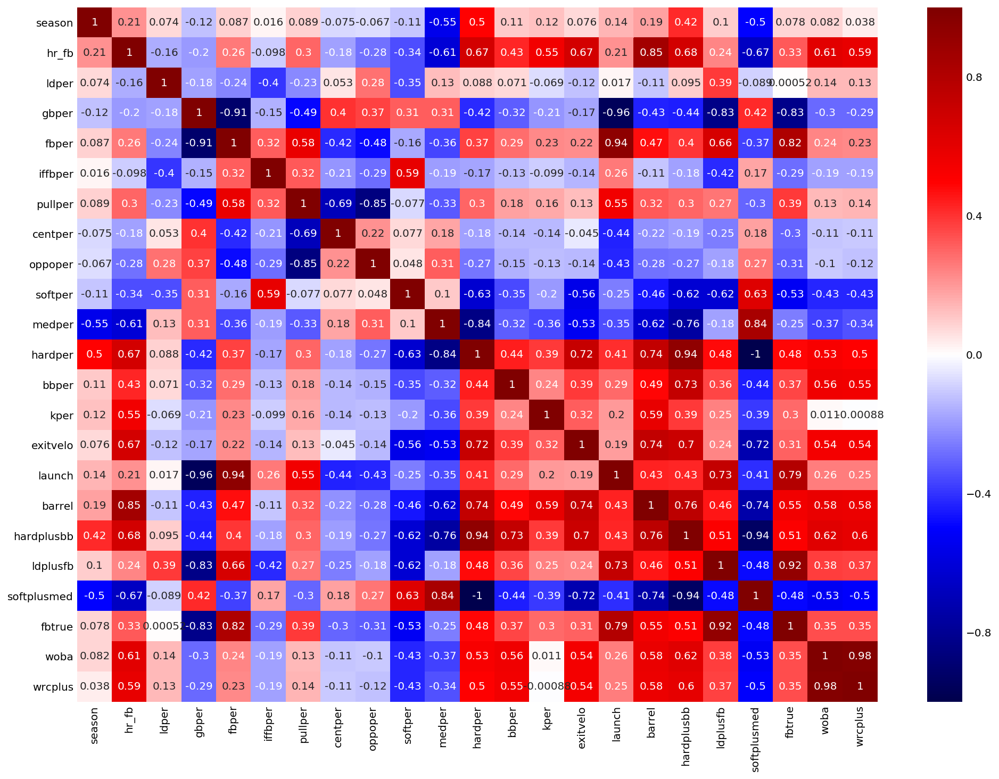

In [11]:
# plt.style.use('dark_background')
# %matplotlib inline
plt.figure(figsize=[15,12])
sns.heatmap(fg_data.corr(), cmap="seismic", annot=True, vmin=-1, vmax=1);

In [12]:
fg_data.corr()

,season,hr_fb,ldper,gbper,fbper,iffbper,pullper,centper,oppoper,softper,...,kper,exitvelo,launch,barrel,hardplusbb,ldplusfb,softplusmed,fbtrue,woba,wrcplus
season,1.000000,0.211091,0.074486,-0.119318,0.087130,0.015964,0.089242,-0.074591,-0.066694,-0.114690,...,0.124386,0.076474,0.143098,0.185238,0.419839,0.101209,-0.495746,0.078411,0.082144,0.037545
hr_fb,0.211091,1.000000,-0.156493,-0.201630,0.264930,-0.098343,0.300191,-0.180438,-0.276393,-0.344759,...,0.547840,0.667600,0.214766,0.853349,0.677359,0.240817,-0.667271,0.327667,0.614959,0.587805
ldper,0.074486,-0.156493,1.000000,-0.182075,-0.238168,-0.397253,-0.233230,0.053335,0.277756,-0.346105,...,-0.068815,-0.119757,0.016598,-0.114727,0.095237,0.389820,-0.088743,0.000523,0.136506,0.134517
gbper,-0.119318,-0.201630,-0.182075,1.000000,-0.911597,-0.154323,-0.487773,0.403938,0.369196,0.312885,...,-0.207130,-0.172816,-0.958195,-0.431255,-0.442706,-0.833473,0.415970,-0.828094,-0.295870,-0.291843
fbper,0.087130,0.264930,-0.238168,-0.911597,1.000000,0.318847,0.579313,-0.421196,-0.480871,-0.164371,...,0.232991,0.221141,0.939625,0.474221,0.397774,0.660125,-0.374167,0.817526,0.235759,0.232534
iffbper,0.015964,-0.098343,-0.397253,-0.154323,0.318847,1.000000,0.322106,-0.209649,-0.285635,0.592680,...,-0.098936,-0.141415,0.263183,-0.111482,-0.182901,-0.417274,0.174892,-0.285167,-0.185740,-0.186668
pullper,0.089242,0.300191,-0.233230,-0.487773,0.579313,0.322106,1.000000,-0.694710,-0.853748,-0.076928,...,0.164884,0.125449,0.547467,0.322783,0.299100,0.268455,-0.297350,0.390123,0.134497,0.144493
centper,-0.074591,-0.180438,0.053335,0.403938,-0.421196,-0.209649,-0.694710,1.000000,0.218690,0.077232,...,-0.135316,-0.044896,-0.437422,-0.216598,-0.192628,-0.254171,0.181497,-0.298555,-0.110826,-0.107529
oppoper,-0.066694,-0.276393,0.277756,0.369196,-0.480871,-0.285635,-0.853748,0.218690,1.000000,0.048346,...,-0.125286,-0.137093,-0.426095,-0.280698,-0.266041,-0.179851,0.271598,-0.312732,-0.102499,-0.118439
softper,-0.114690,-0.344759,-0.346105,0.312885,-0.164371,0.592680,-0.076928,0.077232,0.048346,1.000000,...,-0.196519,-0.556474,-0.253422,-0.460844,-0.617984,-0.619451,0.627504,-0.526337,-0.428507,-0.427080


## Modeling

### Base Model

In [13]:
basey = fg_data.wrcplus
basex = fg_data.drop(columns=['season', 'name', 
                              #ignore season and name
                              'woba', 'wrcplus',
                              #drop dependent variable and woba which dependent is derived from
#                               'hr_fb',
#                               'ldper', 
#                               'gbper', 
#                               'fbper', 
#                               'iffbper',
#                               'pullper', 
#                               'centper', 
#                               'oppoper',
#                               'softper', 
#                               'medper', 
#                               'hardper', 
#                               'bbper', 
#                               'kper',
#                               'exitvelo',
#                               'launch',
#                               'barrel',
                              'hardplusbb', 'ldplusfb', 'softplusmed', 'fbtrue'])
                                #drop derived values

In [14]:
basemodel = sm.OLS(basey,sm.add_constant(basex)).fit()
basemodel.summary()

/opt/anaconda3/envs/metis/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2495: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                wrcplus   R-squared:                       0.691
Model:                            OLS   Adj. R-squared:                  0.684
Method:                 Least Squares   F-statistic:                     95.96
Date:                Fri, 24 Jan 2020   Prob (F-statistic):          8.57e-163
Time:                        16:37:58   Log-Likelihood:                -2777.4
No. Observations:                 703   AIC:                             5589.
Df Residuals:                     686   BIC:                             5666.
Df Model:                          16                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        119.8644   1642.613      0.073      0.942   -3105.289    3345.018
hr_fb        197.2594     17.023     11.588      0.000     163.836     230.683
ldper        616.9969    980.232      0.629      0.529   -1307.618    2541.612
gbper        427.4513    979.431      0.436      0.663   -1495.591    2350.493
fbper        495.8240    981.693      0.505      0.614   -1431.659    2423.307
iffbper      -34.6239     19.979     -1.733      0.084     -73.852       4.604
pullper    -1170.7921    960.505     -1.219      0.223   -3056.674     715.090
centper    -1162.4933    961.194     -1.209      0.227   -3049.728     724.741
oppoper    -1147.5575    960.236     -1.195      0.232   -3032.911     737.796
softper      544.8573    969.306      0.562      0.574   -1358.306    2448.021
medper       548.2096    968.480      0.566      0.572   -1353.332    2449.751
hardper      501.2708    968.669      0.517      0.605   -1400.641    2403.182
bbper        186.4532     17.451     10.685      0.000     152.190     220.716
kper        -220.3502     11.748    -18.756      0.000    -243.417    -197.283
exitvelo       1.4151      0.402      3.523      0.000       0.627       2.204
launch        -0.3953      0.499     -0.792      0.429      -1.376       0.585
barrel       146.5220     34.594      4.236      0.000      78.600     214.444
==============================================================================
Omnibus:                        2.129   Durbin-Watson:                   1.272
Prob(Omnibus):                  0.345   Jarque-Bera (JB):                2.164
Skew:                           0.016   Prob(JB):                        0.339
Kurtosis:                       3.270   Cond. No.                     4.33e+05
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 4.33e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

### Lasso Regression

In [15]:
selected_columns = ['ldper', 'hr_fb',
                #   commenting out lasso'd out columns
#                     'pullper', 'centper', 'oppoper',
#                     'softper', 'medper', 
#                     'hardper', 
                    'bbper', 'kper',
                    'exitvelo',
#                     'launch',
                    'barrel']

X = fg_data.loc[:,selected_columns]
#,'hardplusbb', 'ldplusfb', 'softplusmed','fbtrue',
#'woba', 'wrcplus']]

y = fg_data['wrcplus']

In [26]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=81)

In [28]:
X_test.size

846

In [17]:
lasso_model = Lasso(alpha = .1) # this is a VERY HIGH regularization strength!, wouldn't usually be used
lasso_model.fit(X_train.loc[:,selected_columns], y_train)

list(zip(selected_columns, lasso_model.coef_))

[('ldper', 27.660099077048866),
 ('hr_fb', 128.05042695019668),
 ('bbper', 195.42863362054246),
 ('kper', -109.70597982241),
 ('exitvelo', 2.9738540037010552),
 ('barrel', 0.0)]

### Final Model

In [18]:
formula = 'wrcplus ~ ldper + hr_fb + bbper + exitvelo + kper + barrel'

dep, Ind = patsy.dmatrices(formula, data=fg_data, return_type="dataframe")


In [19]:
model = sm.OLS(dep,Ind).fit()
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                wrcplus   R-squared:                       0.678
Model:                            OLS   Adj. R-squared:                  0.675
Method:                 Least Squares   F-statistic:                     243.8
Date:                Fri, 24 Jan 2020   Prob (F-statistic):          2.29e-167
Time:                        16:37:58   Log-Likelihood:                -2792.5
No. Observations:                 703   AIC:                             5599.
Df Residuals:                     696   BIC:                             5631.
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     -5.9014     27.856     -0.212      0.832     -60.593      48.790
ldper        160.1262     17.920      8.936      0.000     124.943     195.309
hr_fb        167.1475     15.524     10.767      0.000     136.669     197.626
bbper        191.9822     17.434     11.012      0.000     157.752     226.213
exitvelo       0.8051      0.318      2.534      0.011       0.181       1.429
kper        -220.6923     11.783    -18.730      0.000    -243.826    -197.559
barrel       187.1093     29.439      6.356      0.000     129.310     244.908
==============================================================================
Omnibus:                        1.433   Durbin-Watson:                   1.250
Prob(Omnibus):                  0.489   Jarque-Bera (JB):                1.286
Skew:                          -0.051   Prob(JB):                        0.526
Kurtosis:                       3.183   Cond. No.                     6.52e+03
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 6.52e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [29]:
lr = LinearRegression()

# Fit the model to the full dataset
lr.fit(X_train, y_train)

# Print out the R^2 for the model against the full dataset
print(f'R^2: {lr.score(X_test,y_test)}')
print(f'RMSE: {np.sqrt(mean_squared_error(y_test,lr.predict(X_test)))}')
print(f'MAE: {np.mean(np.abs(lr.predict(X_test)-y_test))}')

R^2: 0.7034149892079925
RMSE: 12.434882618125954
MAE: 9.899351433702893


In [30]:
kf = KFold(n_splits=10, shuffle=True, random_state = 81)
cvs = cross_val_score(lr, X_train, y_train, cv=kf, scoring='r2')
print(cvs)
print(np.mean(cvs))


[0.55113851 0.57260426 0.72411641 0.6006223  0.68069507 0.6942928
 0.74969464 0.5962904  0.68090317 0.61600699]
0.6466364545666288


# Plotting

In [40]:
y_pred = lr.predict(X)
y_test_pred = lr.predict(X_test)

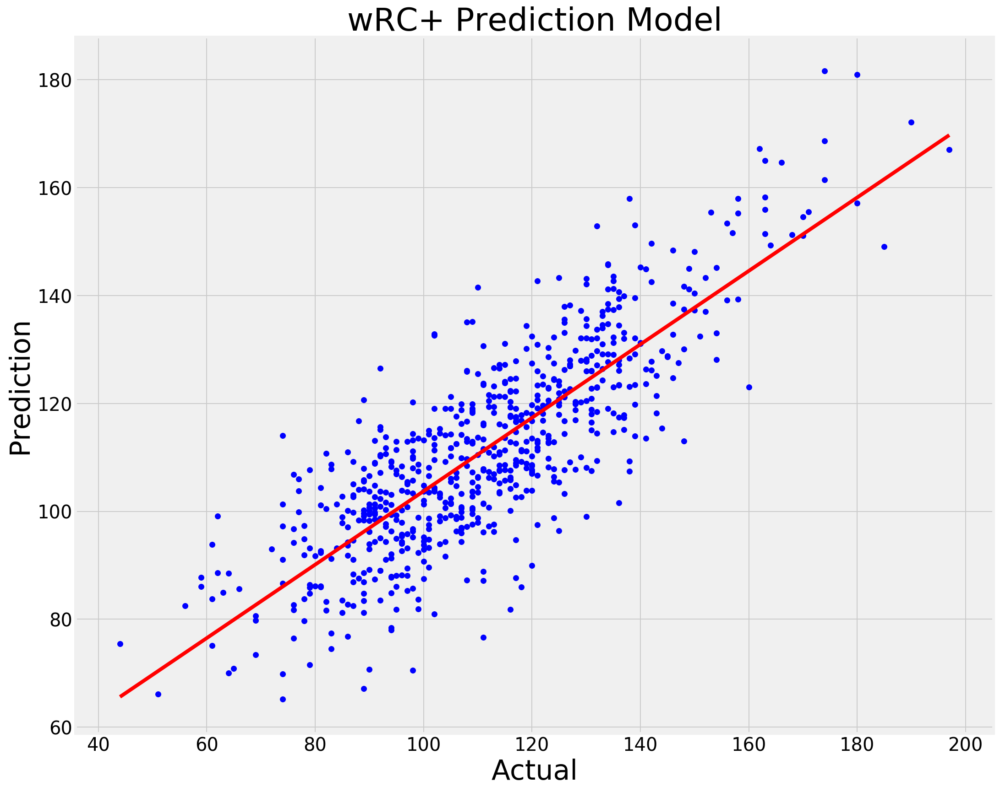

In [41]:
plt.rcParams.update({'font.size': 20})

plt.figure(figsize=(16,14))
plt.plot(y, np.poly1d(np.polyfit(y, y_pred, 1))(y),color='red')
plt.scatter(y,y_pred,color='blue')
plt.title('wRC+ Prediction Model',fontsize=35)
plt.ylabel('Prediction',fontsize=30)
plt.xlabel('Actual',fontsize=30);

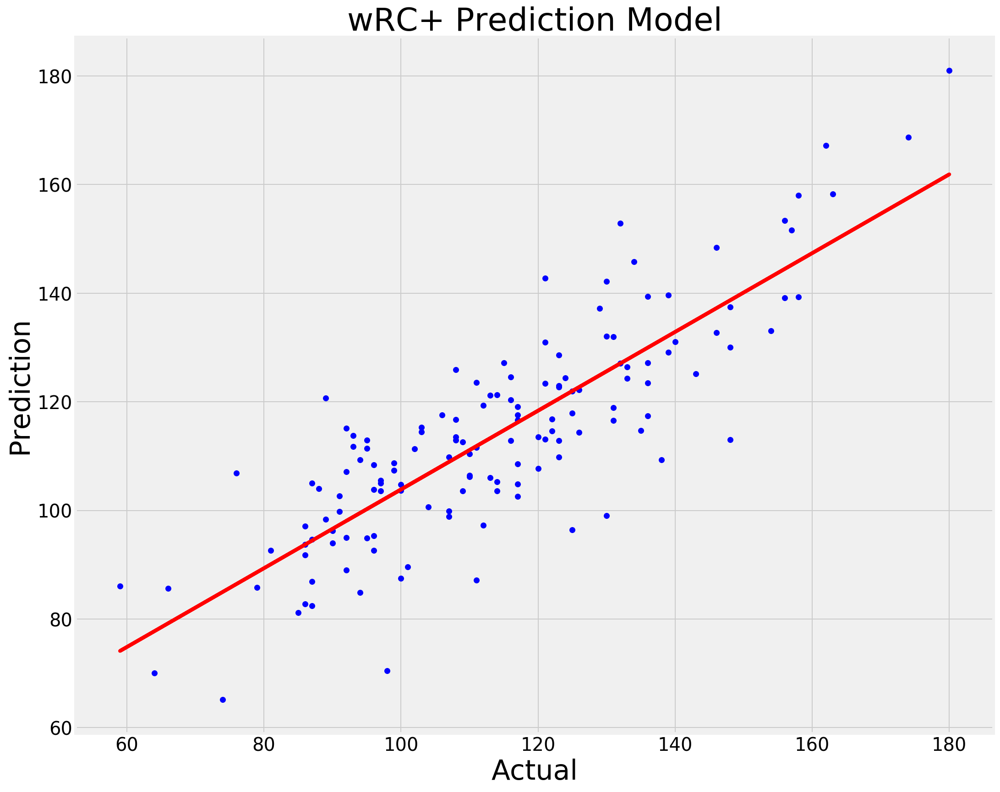

In [42]:
plt.rcParams.update({'font.size': 20})

plt.figure(figsize=(16,14))
plt.plot(y_test, np.poly1d(np.polyfit(y_test, y_test_pred, 1))(y_test),color='red')
plt.scatter(y_test,y_test_pred,color='blue')
plt.title('wRC+ Prediction Model',fontsize=35)
plt.ylabel('Prediction',fontsize=30)
plt.xlabel('Actual',fontsize=30);

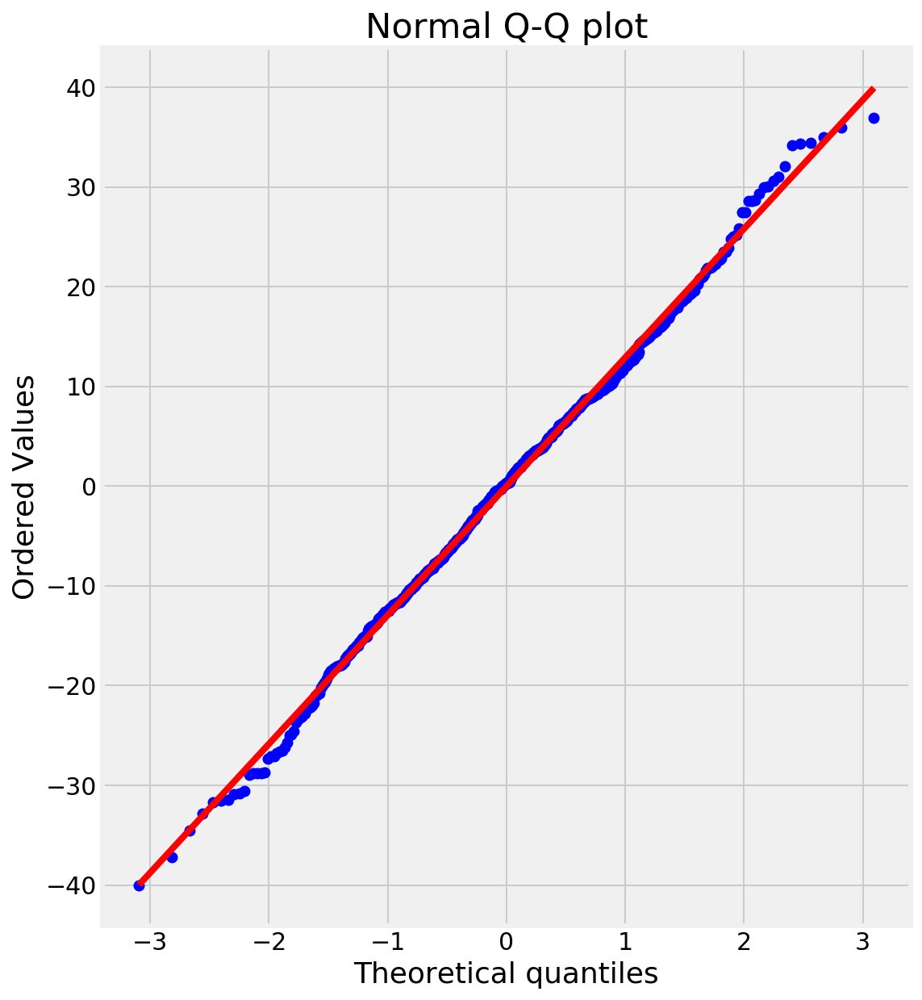

In [43]:
res = y - y_pred
plt.rcParams.update({'font.size': 15})
plt.figure(figsize=(8,10))
stats.probplot(res, dist="norm", plot=plt)
plt.title("Normal Q-Q plot");

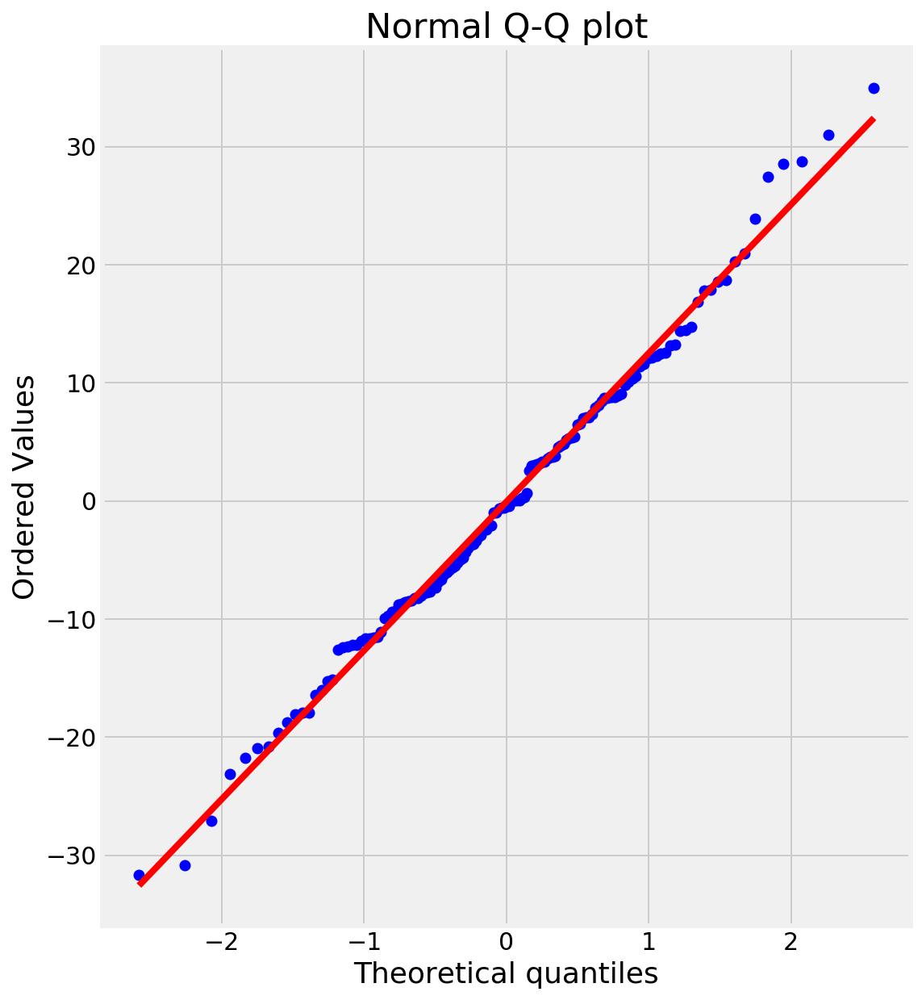

In [39]:
res = y_test - y_test_pred
plt.rcParams.update({'font.size': 15})
plt.figure(figsize=(8,10))
stats.probplot(res, dist="norm", plot=plt)
plt.title("Normal Q-Q plot");